In [1]:
import scanpy as sc
import pandas as pd
import numpy as np
import os
import scvi
import torch
import warnings
import leidenalg as la
import anndata
from matplotlib import pyplot as plt
from matplotlib.pyplot import rc_context
from scvi.autotune import ModelTuner
from ray import tune
import glob
import re
import csv
import itertools
from scipy.io import mmwrite
import pynndescent
import umap
import random
warnings.filterwarnings('ignore')
sc.set_figure_params(dpi=200)
plt.rcParams['figure.figsize'] = [3,3]

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

In [2]:
os.chdir('/media/MPEdge16/MM137/sc/py/py_out/')

In [75]:
myeloid_platelet = sc.read_h5ad('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_myeloid_platelet_int_dbl.h5ad')

In [76]:
myeloid_platelet.obs['cell_group'].value_counts()

cell_group
Myeloid     112270
Platelet      3057
Name: count, dtype: int64

In [77]:
myeloid_platelet = myeloid_platelet[myeloid_platelet.obs['solo_prediction']=='singlet']

In [82]:
adata = anndata.AnnData(X = myeloid_platelet.layers['counts'], obs = myeloid_platelet.obs, var = myeloid_platelet.raw.var)
sc.pp.filter_cells(adata, min_genes = 200)
sc.pp.filter_genes(adata, min_cells = 10)
adata.var['MT'] = adata.var_names.str.startswith('MT-')
adata = adata[adata.obs.pct_counts_MT <= 10]
adata.layers['counts'] = adata.X.copy()
sc.pp.normalize_total(adata, target_sum = 1e4)
sc.pp.log1p(adata)
adata.raw = adata
sc.pp.highly_variable_genes(adata, n_top_genes=5000, subset = False, layer = 'counts', 
                            flavor = "seurat_v3", batch_key="lane")
adata_var = adata.var
csv_data = pd.read_csv('/media/MPEdge16/MM137/sc/EXCLUDE_XY_TCR_IG.csv', header = None)

positions = np.where(adata.var_names.isin(csv_data[0]))[0]
adata.var.iloc[positions, adata.var.columns.get_loc('highly_variable')] = False
adata.var['highly_variable'].value_counts()

highly_variable
False    16014
True      4731
Name: count, dtype: int64

In [83]:
np.all(adata.layers['counts'].data == adata.layers['counts'].data.astype(np.int32))

True

In [7]:
model_cls = scvi.model.SCVI
model_cls.setup_anndata(adata = adata, layer = "counts", batch_key = 'lane', 
                        categorical_covariate_keys=['study_id'], 
                        continuous_covariate_keys=['pct_counts_MT', 'total_counts'])
tuner = ModelTuner(model_cls)
search_space = {
    "n_hidden": tune.choice([92, 128, 192, 256]),
    "n_latent": tune.choice([10, 20, 30, 40, 50, 60]),
    "n_layers": tune.choice([1, 2, 3]),
    "lr": tune.loguniform(1e-4, 1e-2),
    "gene_likelihood": tune.choice(["nb", "zinb"])}
results = tuner.fit(adata, metric="validation_loss",
                    resources = {'gpu': 1}, 
                    search_space = search_space,
                    num_samples = 100,
                    max_epochs = 20)

2024-11-05 15:11:27,608	INFO worker.py:1749 -- Started a local Ray instance.
2024-11-05 15:11:28,886	INFO tune.py:253 -- Initializing Ray automatically. For cluster usage or custom Ray initialization, call `ray.init(...)` before `Tuner(...)`.
2024-11-05 15:11:28,891	INFO tune.py:614 -- [output] This uses the legacy output and progress reporter, as Jupyter notebooks are not supported by the new engine, yet. For more information, please see https://github.com/ray-project/ray/issues/36949
(_trainable pid=106629) /media/MPEdge16/miniconda_ns/lib/python3.9/abc.py:119: FutureWarning: SparseDataset is deprecated and will be removed in late 2024. It has been replaced by the public classes CSRDataset and CSCDataset.
(_trainable pid=106629) 
(_trainable pid=106629) For instance checks, use `isinstance(X, (anndata.experimental.CSRDataset, anndata.experimental.CSCDataset))` instead.
(_trainable pid=106629) 
(_trainable pid=106629) For creation, use `anndata.experimental.sparse_dataset(X)` instead.

In [8]:
best_vl = 10000
best_i = 0
for i in range(len(results.results)):
    if 'validation_loss' in results.results[i].metrics.keys():
        vl = results.results[i].metrics['validation_loss']
        if vl < best_vl:
            best_vl = vl
            best_i = i
    else:
        continue

In [9]:
tuner_res = str(results.results[best_i])
tuner_res

"Result(\n  metrics={'validation_loss': 4218.1533203125},\n  path='/media/MPEdge16/MM137/sc/py/scvi_log/autotune/2024-11-05_15-11-20_scvi/_trainable_ca823412_73_gene_likelihood=nb,lr=0.0064,n_hidden=256,n_latent=10,n_layers=1_2024-11-05_15-56-39',\n  filesystem='local',\n  checkpoint=None\n)"

In [10]:
match_gene_likelihood_1 = re.compile(r'gene_likelihood=(nb|zinb)')
gl_1 = match_gene_likelihood_1.search(tuner_res).group()
match_gene_likelihood_2 = re.compile(r'(nb|zinb)')
gene_likelihood_param = match_gene_likelihood_2.search(gl_1).group()

In [11]:
nlayer_1 = re.compile(r'n_layers=[0-9]+')
nl_1 = nlayer_1.search(tuner_res).group()
nlayer_2 = re.compile(r'[0-9]+')
n_layers_param = int(nlayer_2.search(nl_1).group())

In [12]:
nlatent_1 = re.compile(r'n_latent=[0-9]+')
nlat_1 = nlatent_1.search(tuner_res).group()
nlatent_2 = re.compile(r'[0-9]+')
n_latent_param = int(nlatent_2.search(nlat_1).group())

In [13]:
nhidden_1 = re.compile(r'n_hidden=[0-9]+')
nh_1 = nhidden_1.search(tuner_res).group()
nhidden_2 = re.compile(r'[0-9]+')
n_hidden_param = int(nhidden_2.search(nh_1).group())

In [14]:
learn_1 = re.compile(r'lr=[0-9\\.]+')
lr_1 = learn_1.search(tuner_res).group()
learn_2 = re.compile(r'[0-9\\.]+')
lr_param = float(learn_2.search(lr_1).group())

In [15]:
{'n_hidden': n_hidden_param, 
'n_latent': n_latent_param, 
'n_layers': n_layers_param, 
'gene_likelihood': gene_likelihood_param, 
'lr': lr_param}

{'n_hidden': 256,
 'n_latent': 10,
 'n_layers': 1,
 'gene_likelihood': 'nb',
 'lr': 0.0064}

In [16]:
scvi.model.SCVI.setup_anndata(adata = adata, layer = "counts", batch_key = 'lane', 
                              categorical_covariate_keys=['study_id'], 
                              continuous_covariate_keys=['pct_counts_MT', 'total_counts'])
model = scvi.model.SCVI(adata, n_hidden = n_hidden_param, n_latent = n_latent_param, n_layers = n_layers_param, gene_likelihood = gene_likelihood_param)
kwargs = {'lr': lr_param}
model.train(max_epochs = 200, early_stopping = True, plan_kwargs = kwargs)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
You are using a CUDA device ('NVIDIA RTX 4000 Ada Generation') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 200/200: 100%|████████████████████████████████████████████████| 200/200 [26:28<00:00,  7.93s/it, v_num=1, train_loss_step=3.94e+3, train_loss_epoch=4.22e+3]

`Trainer.fit` stopped: `max_epochs=200` reached.


Epoch 200/200: 100%|████████████████████████████████████████████████| 200/200 [26:28<00:00,  7.94s/it, v_num=1, train_loss_step=3.94e+3, train_loss_epoch=4.22e+3]


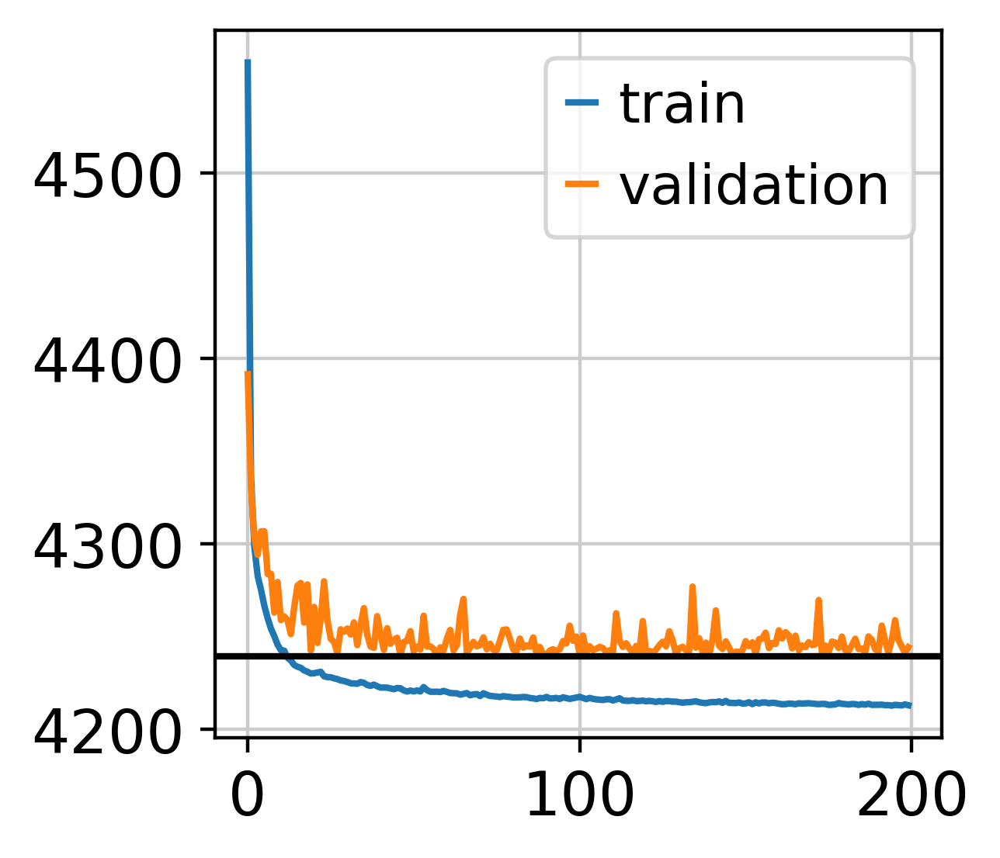

In [17]:
y = model.history['reconstruction_loss_validation']['reconstruction_loss_validation'].min()
plt.plot(model.history['reconstruction_loss_train']['reconstruction_loss_train'], label='train')
plt.plot(model.history['reconstruction_loss_validation']['reconstruction_loss_validation'], label='validation')

plt.axhline(y, c = 'k')

plt.legend()
plt.show()

In [3]:
adata = sc.read_h5ad('/media/MPEdge16/MM137/sc/py/py_out/pbmc/temp_pbmc_myeloid_platelet_singlet.h5ad')
#model.save('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_myeloid_platelet_scvi_integration_model_singlet')
model = scvi.model.SCVI.load('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_myeloid_platelet_scvi_integration_model_singlet/', adata)
#adata.write_h5ad('/media/MPEdge16/MM137/sc/py/py_out/pbmc/temp_pbmc_myeloid_platelet_singlet.h5ad')

INFO     File /media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_myeloid_platelet_scvi_integration_model_singlet/model.pt
         already downloaded                                                                                        


In [4]:
adata.obsm['X_scVI'] = model.get_latent_representation()
scvi_norm_count = model.get_normalized_expression(library_size = 1e4)
adata.layers['scvi_normalized'] = scvi_norm_count

In [5]:
sc.pp.neighbors(adata, use_rep = 'X_scVI', random_state = 123)
sc.tl.umap(adata)

In [6]:
sc.tl.leiden(adata, resolution = 2, key_added = 'leiden')

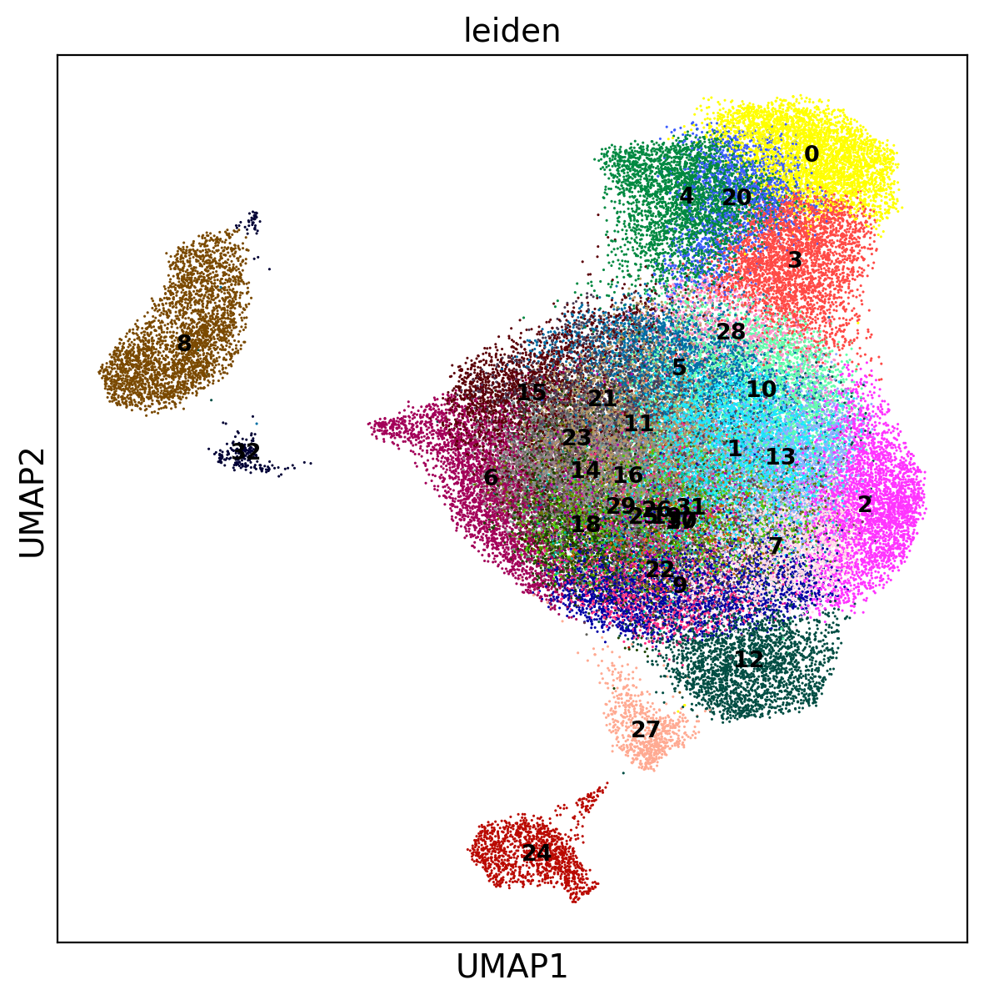

In [26]:
sc.set_figure_params(dpi=100)
plt.rcParams['figure.figsize'] = [7,7]
sc.pl.umap(adata, color = ['leiden'], legend_loc = 'on data', size = 5, layer = 'scvi_normalized', legend_fontsize = 'x-small')

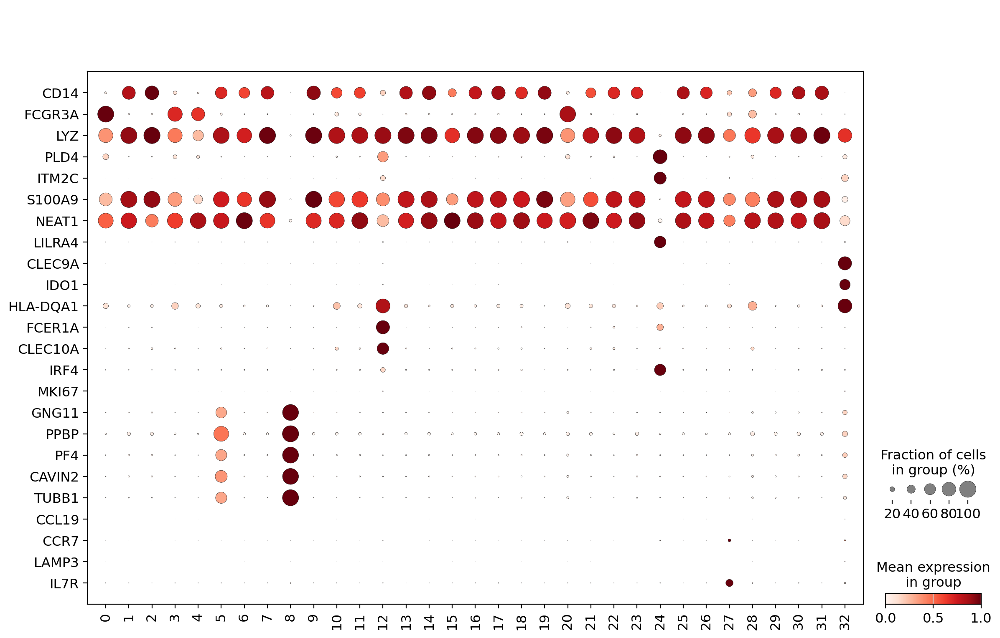

In [21]:
sc.set_figure_params(dpi=100)
sc.pl.dotplot(adata, ['CD14','FCGR3A','LYZ','PLD4','ITM2C','S100A9','NEAT1','LILRA4','CLEC9A','IDO1','HLA-DQA1','FCER1A','CLEC10A','IRF4','MKI67','GNG11','PPBP','PF4','CAVIN2','TUBB1','CCL19','CCR7','LAMP3','IL7R'], groupby = 'leiden', swap_axes = True,
              use_raw = True, standard_scale = 'var', dendrogram = False)

In [35]:
nmo = ['0','3','4','20']
cmo = ['1','2','6','7','9','10','11','13','14','15','16','17','18','19','21','22','23','25','26','29','30','31']
cdc1 = ['32']
cdc2 = ['12']
pdc = ['24']
mdc = ['27']
intmo = ['28']
mpa = ['5']
pltlt = ['8']

In [13]:
sc.tl.rank_genes_groups(adata, groupby='leiden', method='t-test')

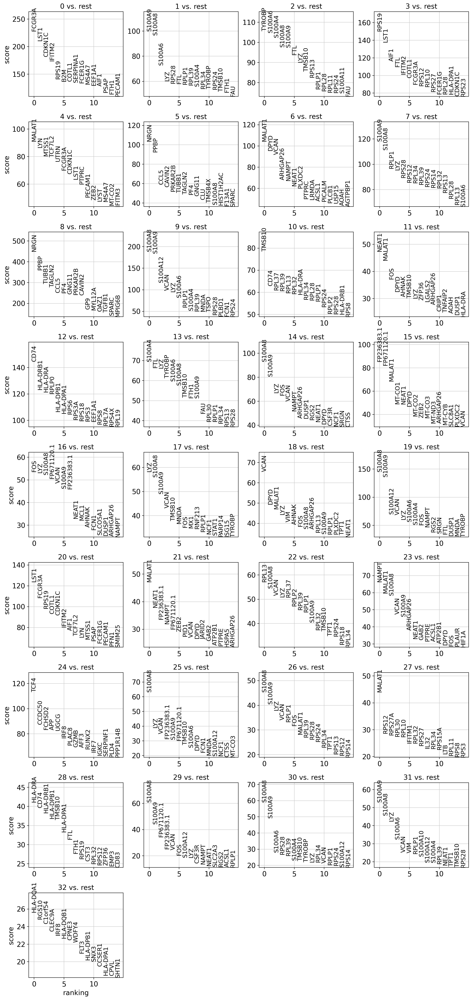

In [16]:
sc.pl.rank_genes_groups(adata, n_genes=15, sharey=False, fontsize = 12)

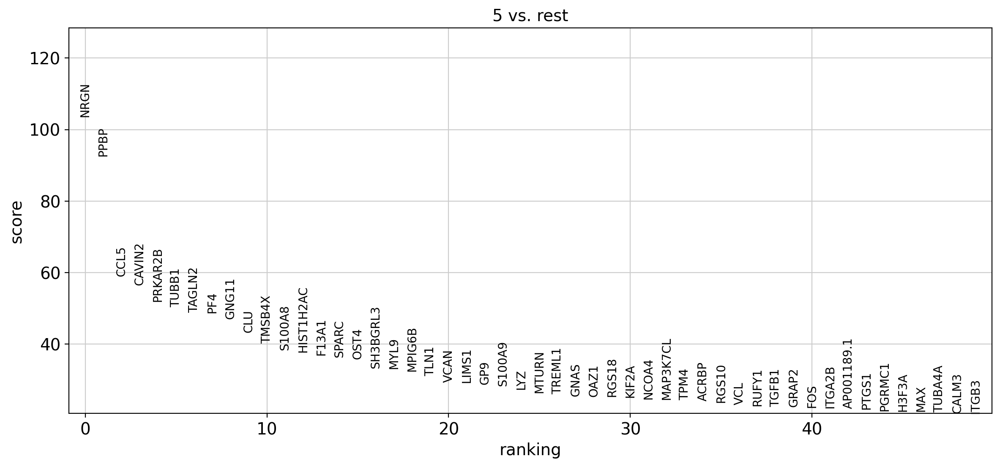

In [17]:
plt.rcParams['figure.figsize'] = [14, 6] # width, height
sc.pl.rank_genes_groups(adata, n_genes=50, groups=['5'], sharey=False, fontsize = 10)

In [36]:
ann = ['cMo' if x in cmo else x for x in adata.obs['leiden']]
ann = ['nMo' if x in nmo else y for x,y in zip(adata.obs['leiden'],ann)]
ann = ['cDC1' if x in cdc1 else y for x,y in zip(adata.obs['leiden'],ann)]
ann = ['cDC2' if x in cdc2 else y for x,y in zip(adata.obs['leiden'],ann)]
ann = ['pDC' if x in pdc else y for x,y in zip(adata.obs['leiden'],ann)]
ann = ['migratory DC' if x in mdc else y for x,y in zip(adata.obs['leiden'],ann)]
ann = ['Int Mono' if x in intmo else y for x,y in zip(adata.obs['leiden'],ann)]
ann = ['MPA' if x in mpa else y for x,y in zip(adata.obs['leiden'],ann)]
ann = ['Platelet' if x in pltlt else y for x,y in zip(adata.obs['leiden'],ann)]
adata.obs['annotation'] = ann

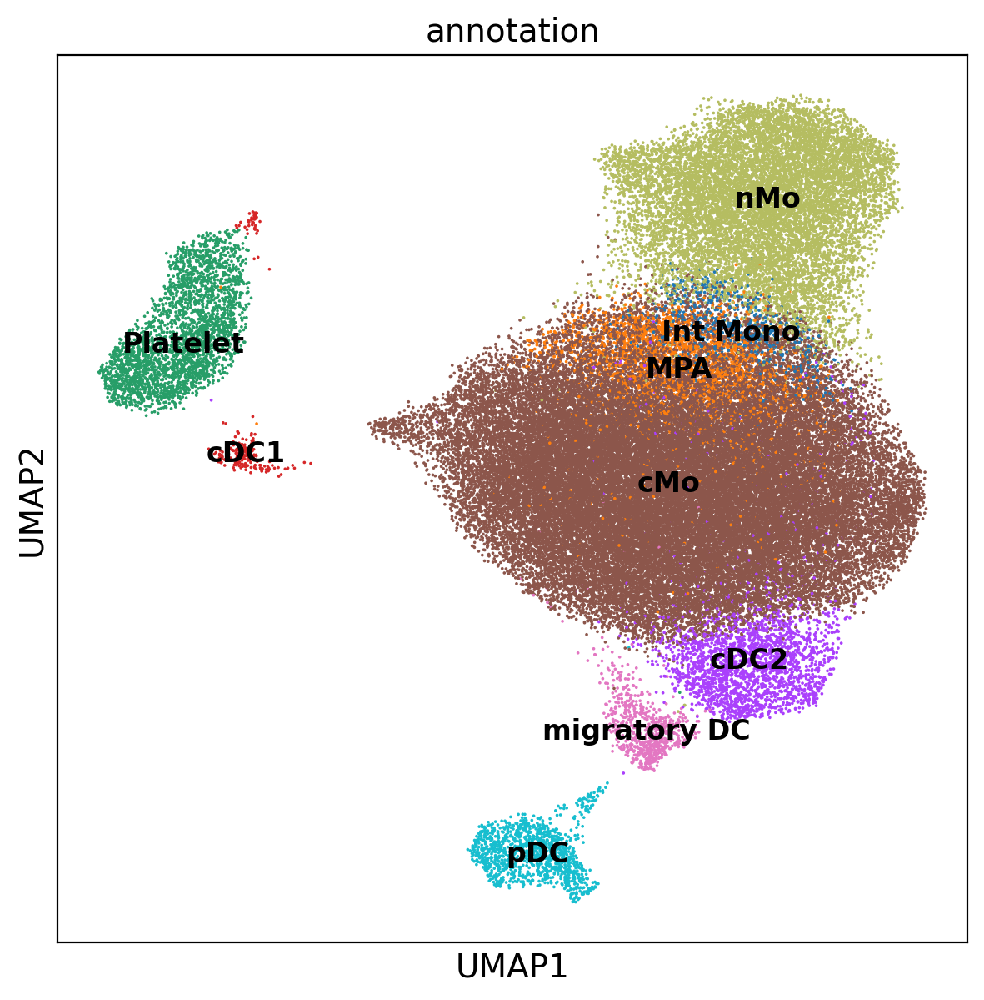

In [38]:
sc.set_figure_params(dpi=100)
plt.rcParams['figure.figsize'] = [7,7]
sc.pl.umap(adata, color = ['annotation'], legend_loc = 'on data', size = 7, legend_fontsize = 12)

In [39]:
#adata.write_h5ad('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_myeloid_platelet_int_singlet.h5ad')
#adata = sc.read_h5ad('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_myeloid_platelet_int_singlet.h5ad')

In [ ]:
# now sim doublets; record barcodese; rerun analysis; are MPA and simulated MPA different?

In [3]:
adata = sc.read_h5ad('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_myeloid_platelet_int_singlet.h5ad')

In [4]:
adata.obs['annotation'].value_counts()

annotation
cMo             43052
nMo             11314
MPA              2960
Platelet         2807
cDC2             2465
pDC              1216
migratory DC      708
Int Mono          707
cDC1              223
Name: count, dtype: int64

In [5]:
unique_pid = adata.obs['study_id'].values.unique(); unique_pid

['Sadie-011', 'Sadie-016', 'Sadie-018', 'Sadie-038', 'Sadie-036', 'Sadie-023', 'Sadie-029', 'Sadie-026']
Categories (8, object): ['Sadie-011', 'Sadie-016', 'Sadie-018', 'Sadie-023', 'Sadie-026', 'Sadie-029', 'Sadie-036', 'Sadie-038']

In [6]:
def generate_oligo_tag(length=16):
    return ''.join(random.choices('CGAT', k=length))

def generate_unique_oligo_tags(num_tags, length=16):
    unique_tags = set()
    while len(unique_tags) < num_tags:
        new_tag = generate_oligo_tag(length) + '-dbl'
        unique_tags.add(new_tag)
    return list(unique_tags)

In [7]:
adata_cmo = adata[adata.obs['annotation']=='cMo']
adata_plt = adata[adata.obs['annotation']=='Platelet']
adata_cmo_sd1 = adata_cmo[adata_cmo.obs['study_day']=='SD1']
adata_cmo_sd2 = adata_cmo[adata_cmo.obs['study_day']=='SD2']
adata_cmo_sd3 = adata_cmo[adata_cmo.obs['study_day']=='SD3']
adata_plt_sd1 = adata_plt[adata_plt.obs['study_day']=='SD1']
adata_plt_sd2 = adata_plt[adata_plt.obs['study_day']=='SD2']
adata_plt_sd3 = adata_plt[adata_plt.obs['study_day']=='SD3']

In [8]:
doublet_list = []
np.random.seed(123)
for i in range(len(unique_pid)):
    tmp_id = unique_pid[i]
    print('formulating anndata object with simulated cMo + Platelet doublets for pid: [' + tmp_id + '] ', str(i+1), ' of ',len(unique_pid), ' pid ...')

    sd1_cmo = adata_cmo_sd1[adata_cmo_sd1.obs['study_id']==tmp_id]
    sd2_cmo = adata_cmo_sd2[adata_cmo_sd2.obs['study_id']==tmp_id]
    sd3_cmo = adata_cmo_sd3[adata_cmo_sd3.obs['study_id']==tmp_id]
    sd1_plt = adata_plt_sd1[adata_plt_sd1.obs['study_id']==tmp_id]
    sd2_plt = adata_plt_sd2[adata_plt_sd2.obs['study_id']==tmp_id]
    sd3_plt = adata_plt_sd3[adata_plt_sd3.obs['study_id']==tmp_id]
    # sd1
    min_sd1 = np.min([sd1_cmo.shape[0],sd1_plt.shape[0]])
    sd1_cmo = sd1_cmo[np.random.choice(sd1_cmo.n_obs, size=min_sd1, replace=False)]
    sd1_plt = sd1_plt[np.random.choice(sd1_plt.n_obs, size=min_sd1, replace=False)]
    #sd1_sim_ct = sd1_cmo.X + sd1_plt.X
    sd1_sim_ct = sd1_cmo.layers['counts'] + sd1_plt.layers['counts']
    assert sd1_cmo.n_obs == sd1_plt.n_obs, "The number of cells in both [SD1] AnnData objects must be the same."
    assert all(sd1_cmo.var_names == sd1_plt.var_names), "The feature names (var_names) in both [SD1] AnnData objects must be the same."
    sd1_adata_sim = anndata.AnnData(sd1_sim_ct, var=sd1_cmo.var)
    sd1_adata_sim.obs['lane'] = [x if x==y else x+'_'+y for x,y in zip(sd1_cmo.obs['lane'],sd1_plt.obs['lane'])]
    sd1_adata_sim.obs['study_day'] = 'SD1'
    # sd2
    min_sd2 = np.min([sd2_cmo.shape[0],sd2_plt.shape[0]])
    sd2_cmo = sd2_cmo[np.random.choice(sd2_cmo.n_obs, size=min_sd2, replace=False)]
    sd2_plt = sd2_plt[np.random.choice(sd2_plt.n_obs, size=min_sd2, replace=False)]
    #sd2_sim_ct = sd2_cmo.X + sd2_plt.X
    sd2_sim_ct = sd2_cmo.layers['counts'] + sd2_plt.layers['counts']
    assert sd2_cmo.n_obs == sd2_plt.n_obs, "The number of cells in both [SD2] AnnData objects must be the same."
    assert all(sd2_cmo.var_names == sd2_plt.var_names), "The feature names (var_names) in both [SD2] AnnData objects must be the same."
    sd2_adata_sim = anndata.AnnData(sd2_sim_ct, var=sd2_cmo.var)
    sd2_adata_sim.obs['lane'] = [x if x==y else x+'_'+y for x,y in zip(sd2_cmo.obs['lane'],sd2_plt.obs['lane'],)]
    sd2_adata_sim.obs['study_day'] = 'SD2'
    # sd3
    min_sd3 = np.min([sd3_cmo.shape[0],sd3_plt.shape[0]])
    sd3_cmo = sd3_cmo[np.random.choice(sd3_cmo.n_obs, size=min_sd3, replace=False)]
    sd3_plt = sd3_plt[np.random.choice(sd3_plt.n_obs, size=min_sd3, replace=False)]
    #sd3_sim_ct = sd3_cmo.X + sd3_plt.X
    sd3_sim_ct = sd3_cmo.layers['counts'] + sd3_plt.layers['counts']
    assert sd3_cmo.n_obs == sd3_plt.n_obs, "The number of cells in both [SD3] AnnData objects must be the same."
    assert all(sd3_cmo.var_names == sd3_plt.var_names), "The feature names (var_names) in both [SD3] AnnData objects must be the same."
    sd3_adata_sim = anndata.AnnData(sd3_sim_ct, var=sd3_cmo.var)
    sd3_adata_sim.obs['lane'] = [x if x==y else x+'_'+y for x,y in zip(sd3_cmo.obs['lane'],sd3_plt.obs['lane'],)]
    sd3_adata_sim.obs['study_day'] = 'SD3'

    doublet_adata = anndata.concat([sd1_adata_sim, sd2_adata_sim, sd3_adata_sim])
    num_tags = doublet_adata.n_obs
    unique_oligo_tags = generate_unique_oligo_tags(num_tags)
    oligo_tags = [generate_oligo_tag() + '-dbl' for _ in range(doublet_adata.n_obs)]
    doublet_adata.obs_names = oligo_tags
    doublet_adata.obs['study_id'] = tmp_id
    doublet_adata.obs['map_sd'] = [x.replace('-','').upper()+'_'+y.replace('MM-','') for x,y in zip(doublet_adata.obs['study_id'],doublet_adata.obs['lane'])]
    doublet_adata.obs['souporcell_status'] = 'sim_doublet'
    doublet_adata.obs['souporcell_assignment'] = tmp_id
    doublet_adata.obs['barcode_2'] = doublet_adata.obs_names
    doublet_adata.obs['solo_prediction'] = 'cMo_Platelet_doublet'
    doublet_adata.var['MT'] = doublet_adata.var_names.str.startswith('MT-')
    sc.pp.calculate_qc_metrics(doublet_adata, inplace=True, qc_vars = ['MT'])
    doublet_list.append(doublet_adata)
concatenated_doublets = anndata.concat(doublet_list)

formulating anndata object with simulated cMo + Platelet doublets for pid: [Sadie-011]  1  of  8  pid ...
formulating anndata object with simulated cMo + Platelet doublets for pid: [Sadie-016]  2  of  8  pid ...
formulating anndata object with simulated cMo + Platelet doublets for pid: [Sadie-018]  3  of  8  pid ...
formulating anndata object with simulated cMo + Platelet doublets for pid: [Sadie-038]  4  of  8  pid ...
formulating anndata object with simulated cMo + Platelet doublets for pid: [Sadie-036]  5  of  8  pid ...
formulating anndata object with simulated cMo + Platelet doublets for pid: [Sadie-023]  6  of  8  pid ...
formulating anndata object with simulated cMo + Platelet doublets for pid: [Sadie-029]  7  of  8  pid ...
formulating anndata object with simulated cMo + Platelet doublets for pid: [Sadie-026]  8  of  8  pid ...


In [9]:
concatenated_doublets

AnnData object with n_obs × n_vars = 2807 × 20745
    obs: 'lane', 'study_day', 'study_id', 'map_sd', 'souporcell_status', 'souporcell_assignment', 'barcode_2', 'solo_prediction', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_MT', 'log1p_total_counts_MT', 'pct_counts_MT'

In [10]:
adata.obs

,lane,souporcell_status,souporcell_assignment,study_id,barcode_2,map_sd,study_day,solo_prediction,n_genes,n_genes_by_counts,...,_scvi_labels,overcluster,cell_group,ann_types,singlet_frequency,doublet_frequency,souporcell_doublet_frequency,doublet_sum_frequency,leiden,annotation
barcode_2,,,,,,,,,,,,,,,,,,,,,
AAACCTGAGAGGTTGC-1,MM-1,singlet,0,Sadie-011,AAACCTGAGAGGTTGC-1,SADIE011_1,SD1,singlet,1966,1966,...,0,3,Myeloid,cMo,29.784307,-10.121040,-19.663267,13.462287,14,cMo
AAACCTGAGTCCGGTC-1,MM-1,singlet,2,Sadie-016,AAACCTGAGTCCGGTC-1,SADIE016_1,SD1,singlet,841,841,...,0,6,Myeloid,cMo,27.475566,-7.805270,-19.670297,15.771028,22,cMo
AAACCTGCAATCTACG-1,MM-1,singlet,1,Sadie-018,AAACCTGCAATCTACG-1,SADIE018_1,SD1,singlet,1803,1803,...,0,4,Myeloid,cMo,32.174317,-10.523747,-21.650570,11.072277,6,cMo
AAACCTGGTATATGAG-1,MM-1,singlet,2,Sadie-016,AAACCTGGTATATGAG-1,SADIE016_1,SD1,singlet,2075,2075,...,0,9,Myeloid,cMo,29.670598,-9.575027,-20.095571,13.575996,11,cMo
AAACCTGGTCCATGAT-1,MM-1,singlet,0,Sadie-011,AAACCTGGTCCATGAT-1,SADIE011_1,SD1,singlet,2131,2131,...,0,12,Myeloid,cMo,23.581322,-3.645745,-19.935577,19.665272,17,cMo
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCATCACCTCGT-8,MM-8,singlet,1,Sadie-016,TTTGTCATCACCTCGT-8,SADIE016_8,SD2,singlet,1563,1563,...,0,2,Myeloid,cMo,33.223758,-12.704920,-20.518838,10.022837,7,cMo
TTTGTCATCCCGGATG-8,MM-8,singlet,1,Sadie-016,TTTGTCATCCCGGATG-8,SADIE016_8,SD2,singlet,824,824,...,0,4,Myeloid,cMo,32.174317,-10.523747,-21.650570,11.072277,26,cMo
TTTGTCATCCCTAATT-8,MM-8,singlet,0,Sadie-036,TTTGTCATCCCTAATT-8,SADIE036_8,SD3,singlet,1223,1223,...,0,14,Myeloid,doublet,-54.043059,22.145256,31.897803,97.289654,27,migratory DC


In [11]:
adata.obs[adata.obs['ann_types']=='Platelet']['study_id'].value_counts()

study_id
Sadie-023    788
Sadie-018    510
Sadie-026    477
Sadie-016    320
Sadie-029    296
Sadie-011    201
Sadie-036    124
Sadie-038    119
Name: count, dtype: int64

In [12]:
concatenated_doublets.obs['study_id'].value_counts()

study_id
Sadie-023    777
Sadie-018    501
Sadie-026    472
Sadie-016    319
Sadie-029    294
Sadie-011    202
Sadie-036    124
Sadie-038    118
Name: count, dtype: int64

In [13]:
concatenated_doublets.write_h5ad('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_myeloid_platelet_sim_dbl.h5ad')

### myeloid + platelet adata with simulated cMo + Platelet doublets (per pid)

In [14]:
adata_singlet = sc.read_h5ad('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_myeloid_platelet_int_singlet.h5ad')
adata_singlet = anndata.AnnData(X = adata_singlet.layers['counts'], obs = adata_singlet.obs, var = adata_singlet.var)
all_var = adata_singlet.var_names

In [15]:
adata_singlet.layers['counts'] = adata_singlet.X.copy()
sc.pp.normalize_total(adata_singlet, target_sum = 1e4)
sc.pp.log1p(adata_singlet)
adata_singlet.raw = adata_singlet
sc.pp.highly_variable_genes(adata_singlet, n_top_genes=5000, subset = False, layer = 'counts', 
                            flavor = "seurat_v3", batch_key="lane")
csv_data = pd.read_csv('/media/MPEdge16/MM137/sc/EXCLUDE_XY_TCR_IG.csv', header = None)
positions = np.where(adata_singlet.var_names.isin(csv_data[0]))[0]
adata_singlet.var.iloc[positions, adata_singlet.var.columns.get_loc('highly_variable')] = False
adata_singlet.var['highly_variable'].value_counts()

highly_variable
False    16014
True      4731
Name: count, dtype: int64

In [16]:
adata_singlet.var#.index.values
hvg_features = adata_singlet.var[adata_singlet.var['highly_variable']].index.values
len(hvg_features)

4731

In [31]:
del adata_singlet
adata_singlet = sc.read_h5ad('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_myeloid_platelet_int_singlet.h5ad')
adata_singlet = anndata.AnnData(X = adata_singlet.layers['counts'], obs = adata_singlet.obs, var = adata_singlet.var)

In [39]:
adata_mpa = adata_singlet[adata_singlet.obs['annotation']=='MPA']
mpa_bc_df = pd.DataFrame({'mpa_bc': [x+'_'+y for x,y in zip(adata_mpa.obs['barcode_2'],adata_mpa.obs['lane'])]})
mpa_bc_df.to_csv('/media/MPEdge16/MM137/sc/py/py_out/pbmc/anndata_elements/adata_pbmc_mpa_barcodes.csv', index=False)

In [18]:
adata_2 = sc.read_h5ad('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_myeloid_platelet_sim_dbl.h5ad')
adata_sim = anndata.AnnData(X = adata_2.X, obs = adata_2.obs, var = adata_2.var)

In [19]:
adata = anndata.concat([adata_singlet, adata_2])

In [20]:
adata_singlet

AnnData object with n_obs × n_vars = 65452 × 20745
    obs: 'lane', 'souporcell_status', 'souporcell_assignment', 'study_id', 'barcode_2', 'map_sd', 'study_day', 'solo_prediction', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_MT', 'log1p_total_counts_MT', 'pct_counts_MT', '_scvi_batch', '_scvi_labels', 'overcluster', 'cell_group', 'ann_types', 'singlet_frequency', 'doublet_frequency', 'souporcell_doublet_frequency', 'doublet_sum_frequency', 'leiden', 'annotation'
    var: 'n_cells', 'MT', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'

In [21]:
adata_sim

AnnData object with n_obs × n_vars = 2807 × 20745
    obs: 'lane', 'study_day', 'study_id', 'map_sd', 'souporcell_status', 'souporcell_assignment', 'barcode_2', 'solo_prediction', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_MT', 'log1p_total_counts_MT', 'pct_counts_MT'

In [22]:
# filtering shouldn't drop any cells, features at this point
sc.pp.filter_cells(adata, min_genes = 200)
sc.pp.filter_genes(adata, min_cells = 10)
adata.var['MT'] = adata.var_names.str.startswith('MT-')
adata = adata[adata.obs.pct_counts_MT <= 10]

In [23]:
adata

View of AnnData object with n_obs × n_vars = 68259 × 20745
    obs: 'lane', 'souporcell_status', 'souporcell_assignment', 'study_id', 'barcode_2', 'map_sd', 'study_day', 'solo_prediction', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_MT', 'log1p_total_counts_MT', 'pct_counts_MT', 'n_genes'
    var: 'n_cells', 'MT'

In [24]:
adata.layers['counts'] = adata.X.copy()
sc.pp.normalize_total(adata, target_sum = 1e4)
sc.pp.log1p(adata)
adata.raw = adata

In [25]:
adata.var['highly_variable'] = [True if x in hvg_features else False for x in adata.var_names]

In [26]:
np.all([feature in adata.var.index for feature in hvg_features])
#np.where([feature not in adata.var.index for feature in hvg_features])

True

In [27]:
adata.var['highly_variable'].value_counts()

highly_variable
False    16014
True      4731
Name: count, dtype: int64

In [28]:
np.all(adata.layers['counts'].data == adata.layers['counts'].data.astype(np.int32)) # check if all counts in layers counts are whole int

True

In [29]:
model_cls = scvi.model.SCVI
model_cls.setup_anndata(adata = adata, layer = "counts", batch_key = 'lane', 
                        categorical_covariate_keys=['study_id'], 
                        continuous_covariate_keys=['pct_counts_MT', 'total_counts'])
tuner = ModelTuner(model_cls)
search_space = {
    "n_hidden": tune.choice([92, 128, 192, 256]),
    "n_latent": tune.choice([10, 20, 30, 40, 50, 60]),
    "n_layers": tune.choice([1, 2, 3]),
    "lr": tune.loguniform(1e-4, 1e-2),
    "gene_likelihood": tune.choice(["nb", "zinb"])}
results = tuner.fit(adata, metric="validation_loss",
                    resources = {'gpu': 1}, 
                    search_space = search_space,
                    num_samples = 100,
                    max_epochs = 20)

2024-11-10 14:00:01,047	INFO worker.py:1749 -- Started a local Ray instance.
2024-11-10 14:00:02,319	INFO tune.py:253 -- Initializing Ray automatically. For cluster usage or custom Ray initialization, call `ray.init(...)` before `Tuner(...)`.
2024-11-10 14:00:02,323	INFO tune.py:614 -- [output] This uses the legacy output and progress reporter, as Jupyter notebooks are not supported by the new engine, yet. For more information, please see https://github.com/ray-project/ray/issues/36949
(_trainable pid=2515887) /media/MPEdge16/miniconda_ns/lib/python3.9/abc.py:119: FutureWarning: SparseDataset is deprecated and will be removed in late 2024. It has been replaced by the public classes CSRDataset and CSCDataset.
(_trainable pid=2515887) 
(_trainable pid=2515887) For instance checks, use `isinstance(X, (anndata.experimental.CSRDataset, anndata.experimental.CSCDataset))` instead.
(_trainable pid=2515887) 
(_trainable pid=2515887) For creation, use `anndata.experimental.sparse_dataset(X)` ins

In [30]:
best_vl = 10000
best_i = 0
for i in range(len(results.results)):
    if 'validation_loss' in results.results[i].metrics.keys():
        vl = results.results[i].metrics['validation_loss']
        if vl < best_vl:
            best_vl = vl
            best_i = i
    else:
        continue

In [31]:
tuner_res = str(results.results[best_i])
tuner_res

"Result(\n  metrics={'validation_loss': 4233.9033203125},\n  path='/media/MPEdge16/MM137/sc/py/scvi_log/autotune/2024-11-10_13-59-55_scvi/_trainable_98fdf35e_65_gene_likelihood=zinb,lr=0.0096,n_hidden=192,n_latent=30,n_layers=2_2024-11-10_15-06-42',\n  filesystem='local',\n  checkpoint=None\n)"

In [32]:
match_gene_likelihood_1 = re.compile(r'gene_likelihood=(nb|zinb)')
gl_1 = match_gene_likelihood_1.search(tuner_res).group()
match_gene_likelihood_2 = re.compile(r'(nb|zinb)')
gene_likelihood_param = match_gene_likelihood_2.search(gl_1).group()

In [33]:
nlayer_1 = re.compile(r'n_layers=[0-9]+')
nl_1 = nlayer_1.search(tuner_res).group()
nlayer_2 = re.compile(r'[0-9]+')
n_layers_param = int(nlayer_2.search(nl_1).group())

In [34]:
nlatent_1 = re.compile(r'n_latent=[0-9]+')
nlat_1 = nlatent_1.search(tuner_res).group()
nlatent_2 = re.compile(r'[0-9]+')
n_latent_param = int(nlatent_2.search(nlat_1).group())

In [35]:
nhidden_1 = re.compile(r'n_hidden=[0-9]+')
nh_1 = nhidden_1.search(tuner_res).group()
nhidden_2 = re.compile(r'[0-9]+')
n_hidden_param = int(nhidden_2.search(nh_1).group())

In [36]:
learn_1 = re.compile(r'lr=[0-9\\.]+')
lr_1 = learn_1.search(tuner_res).group()
learn_2 = re.compile(r'[0-9\\.]+')
lr_param = float(learn_2.search(lr_1).group())

In [37]:
{'n_hidden': n_hidden_param, 
'n_latent': n_latent_param, 
'n_layers': n_layers_param, 
'gene_likelihood': gene_likelihood_param, 
'lr': lr_param}

{'n_hidden': 192,
 'n_latent': 30,
 'n_layers': 2,
 'gene_likelihood': 'zinb',
 'lr': 0.0096}

In [38]:
scvi.model.SCVI.setup_anndata(adata = adata, layer = "counts", batch_key = 'lane', 
                              categorical_covariate_keys=['study_id'], 
                              continuous_covariate_keys=['pct_counts_MT', 'total_counts'])
model = scvi.model.SCVI(adata, n_hidden = n_hidden_param, n_latent = n_latent_param, n_layers = n_layers_param, gene_likelihood = gene_likelihood_param)
kwargs = {'lr': lr_param}
model.train(max_epochs = 200, early_stopping = True, plan_kwargs = kwargs)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
You are using a CUDA device ('NVIDIA RTX 4000 Ada Generation') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 200/200: 100%|████████████████████████████████████████████████| 200/200 [31:13<00:00,  9.83s/it, v_num=1, train_loss_step=4.24e+3, train_loss_epoch=4.24e+3]

`Trainer.fit` stopped: `max_epochs=200` reached.


Epoch 200/200: 100%|████████████████████████████████████████████████| 200/200 [31:13<00:00,  9.37s/it, v_num=1, train_loss_step=4.24e+3, train_loss_epoch=4.24e+3]


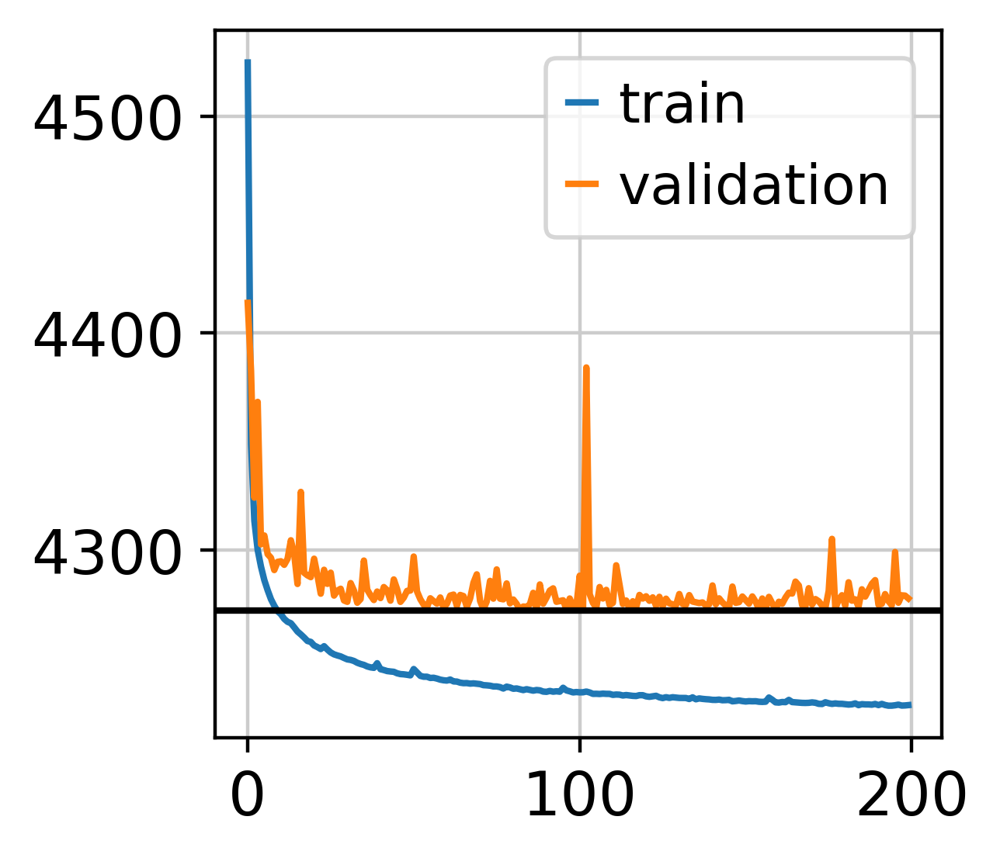

In [39]:
y = model.history['reconstruction_loss_validation']['reconstruction_loss_validation'].min()
plt.plot(model.history['reconstruction_loss_train']['reconstruction_loss_train'], label='train')
plt.plot(model.history['reconstruction_loss_validation']['reconstruction_loss_validation'], label='validation')

plt.axhline(y, c = 'k')

plt.legend()
plt.show()

In [3]:
adata = sc.read_h5ad('/media/MPEdge16/MM137/sc/py/py_out/pbmc/temp_pbmc_myeloid_platelet_sim.h5ad')
#model.save('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_myeloid_platelet_scvi_integration_model_sim')
model = scvi.model.SCVI.load('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_myeloid_platelet_scvi_integration_model_sim/', adata)
#adata.write_h5ad('/media/MPEdge16/MM137/sc/py/py_out/pbmc/temp_pbmc_myeloid_platelet_sim.h5ad')

INFO     File /media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_myeloid_platelet_scvi_integration_model_sim/model.pt    
         already downloaded                                                                                        


In [4]:
adata.obsm['X_scVI'] = model.get_latent_representation()
scvi_norm_count = model.get_normalized_expression(library_size = 1e4)
adata.layers['scvi_normalized'] = scvi_norm_count

In [5]:
sc.pp.neighbors(adata, use_rep = 'X_scVI', random_state = 123)
sc.tl.umap(adata)

In [6]:
sc.tl.leiden(adata, resolution = 2, key_added = 'leiden')

In [40]:
#adata.write_h5ad('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_myeloid_platelet_int_sim.h5ad')
adata = sc.read_h5ad('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_myeloid_platelet_int_sim.h5ad')

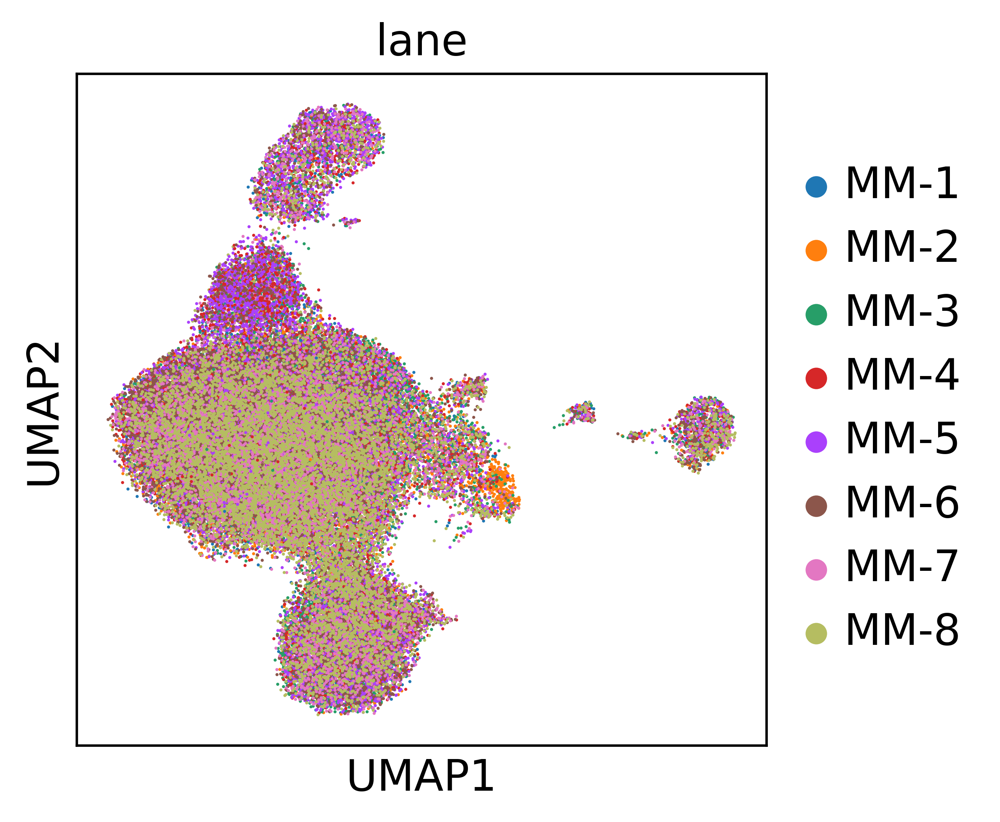

In [8]:
sc.set_figure_params(dpi=300)
sc.pl.umap(adata, color = 'lane', size = 4, legend_fontsize = 'medium')

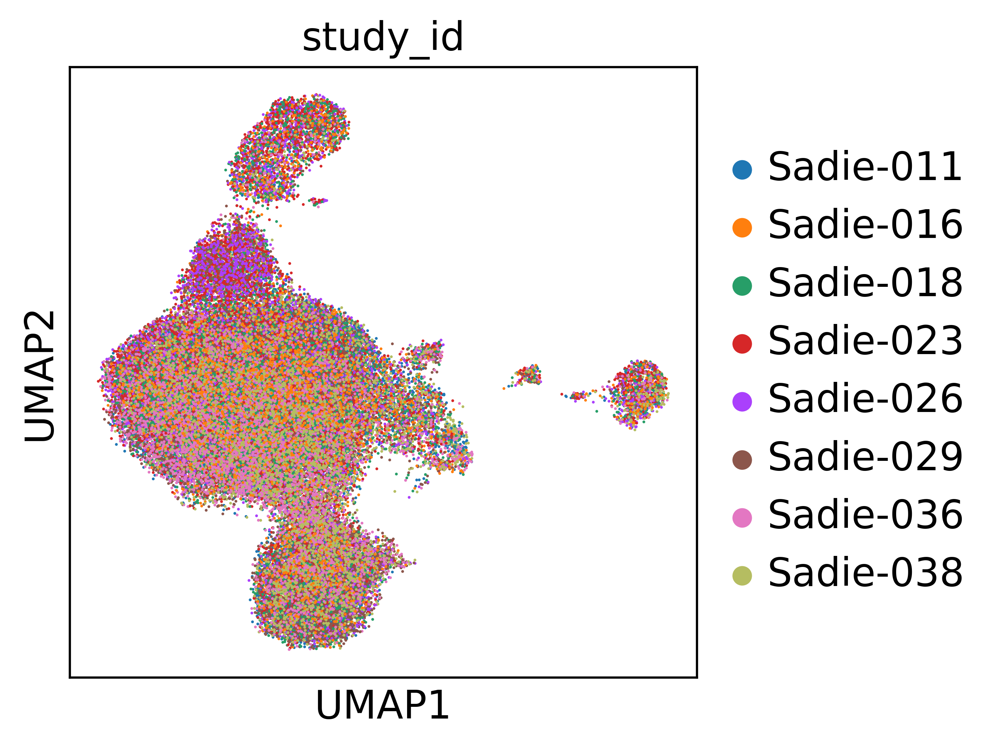

In [9]:
sc.pl.umap(adata, color = 'study_id', size = 4, legend_fontsize = 'medium')

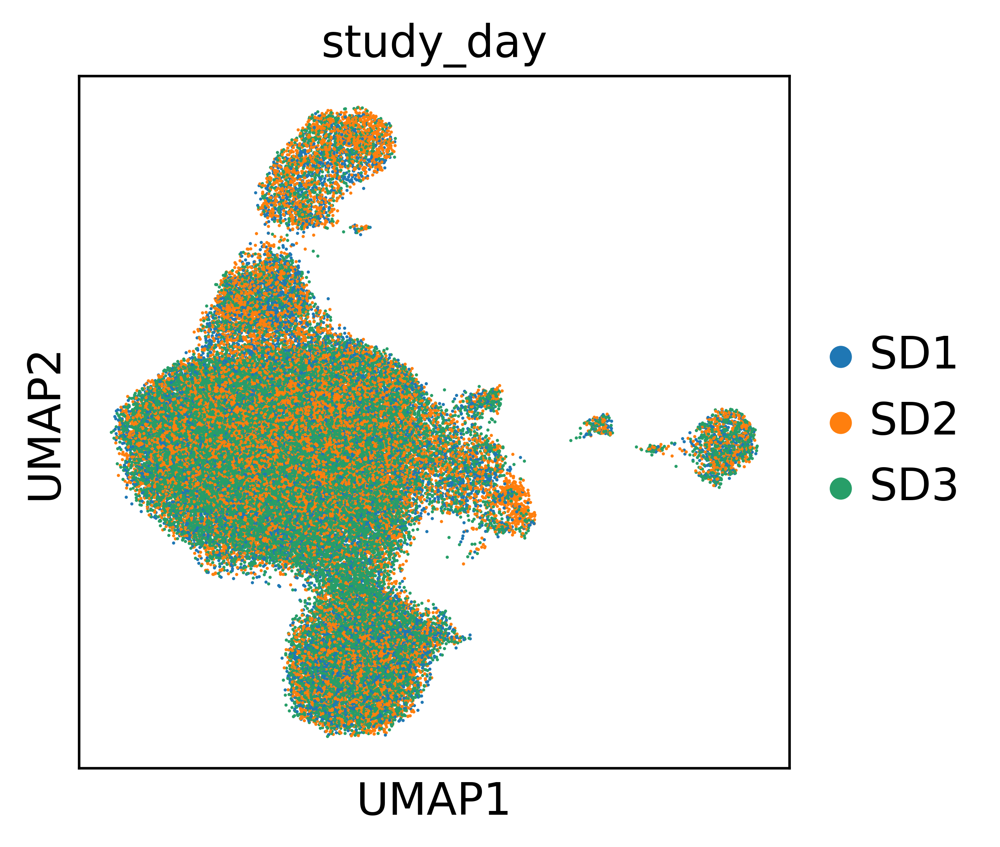

In [10]:
sc.pl.umap(adata, color = 'study_day', size = 4, legend_fontsize = 'medium')

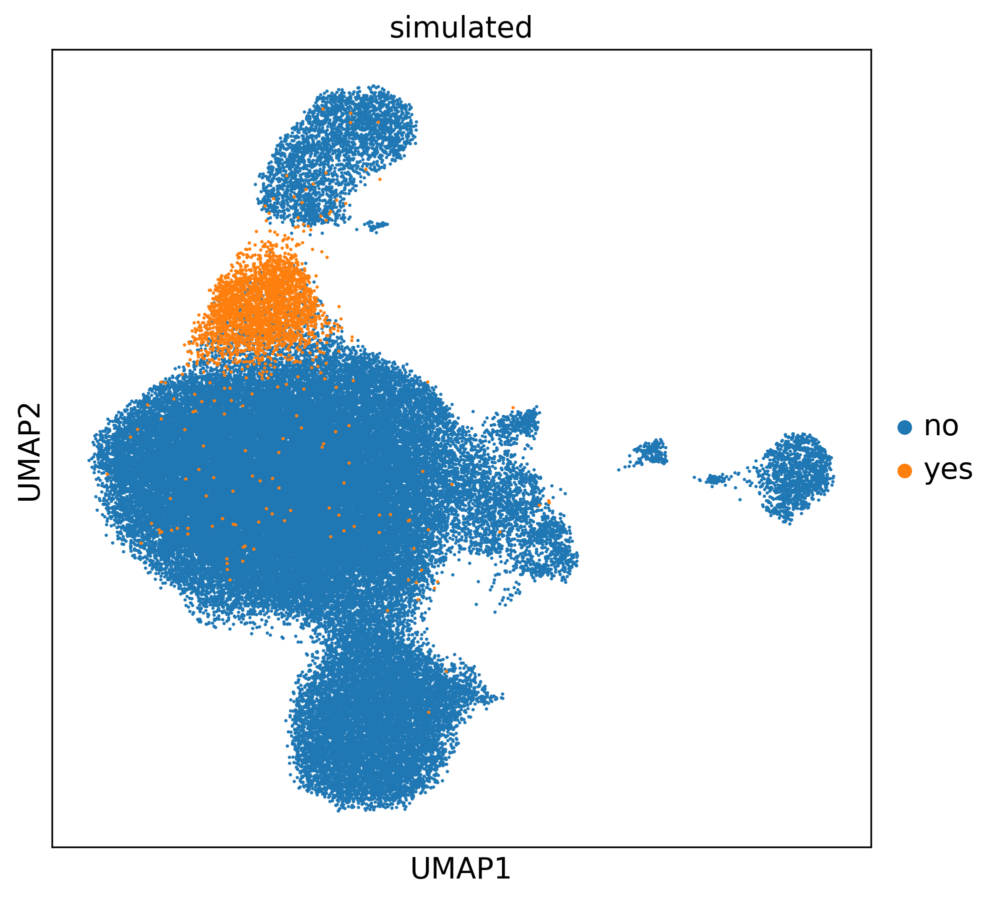

In [62]:
adata.obs['simulated'] = ['yes' if x=='sim_doublet' else 'no' for x in adata.obs['souporcell_status']]
sc.pl.umap(adata, color = 'simulated', size = 10, legend_fontsize = 'medium')

In [65]:
mpa_bc_list['mpa_bc'].values

array(['AAACGGGTCAAAGTAG-1_MM-1', 'AAATGCCGTCCATCCT-1_MM-1',
       'AACACGTCAGAGCCAA-1_MM-1', ..., 'TTGTAGGGTGATGCCC-8_MM-8',
       'TTTACTGTCAGTTTGG-8_MM-8', 'TTTGGTTTCGGATGGA-8_MM-8'], dtype=object)

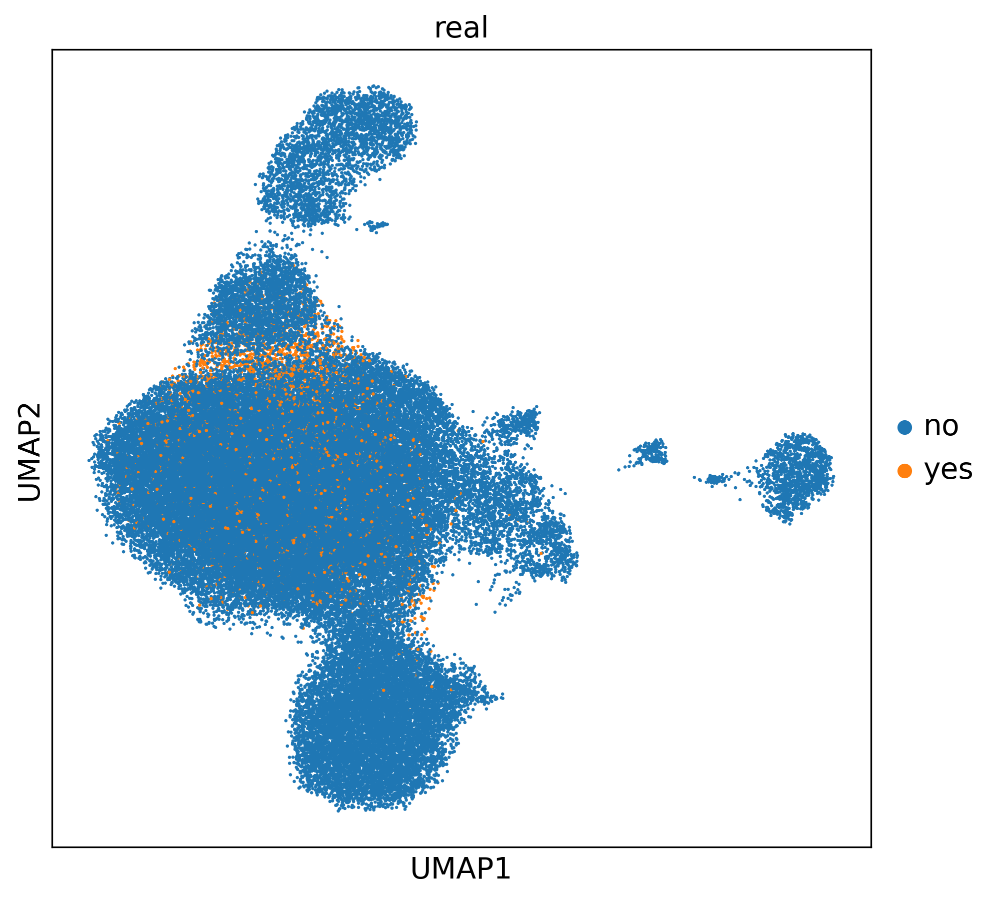

In [66]:
mpa_bc_list = pd.read_csv('/media/MPEdge16/MM137/sc/py/py_out/pbmc/anndata_elements/adata_pbmc_mpa_barcodes.csv')
adata_bc_list = [x+'_'+y for x,y in zip(adata.obs['barcode_2'],adata.obs['lane'])]
adata.obs['real'] = ['yes' if x in mpa_bc_list['mpa_bc'].values else 'no' for x in adata_bc_list]
sc.pl.umap(adata, color = 'real', size = 10, legend_fontsize = 'medium')

In [67]:
adata.obs['real'].value_counts()

real
no     65299
yes     2960
Name: count, dtype: int64

In [68]:
adata.obs['simulated'].value_counts()

simulated
no     65452
yes     2807
Name: count, dtype: int64

In [73]:
adata[adata.obs['real']=='yes'].obs['leiden'].value_counts()

leiden
2     1212
3      181
12     177
17     148
5      138
6      114
4      112
22     108
10      83
16      74
26      72
9       65
13      61
23      61
7       60
18      47
15      47
20      44
19      43
28      30
24      25
21      18
29      16
11      12
27       4
1        3
14       3
0        2
Name: count, dtype: int64

In [74]:
adata[adata.obs['simulated']=='yes'].obs['leiden'].value_counts()

leiden
2     2634
8       33
20      21
9       20
22      14
3       11
17      11
12      11
16       7
5        5
15       5
10       4
4        4
23       4
14       4
30       3
28       2
18       2
26       2
1        1
6        1
13       1
11       1
7        1
19       1
21       1
24       1
27       1
29       1
Name: count, dtype: int64

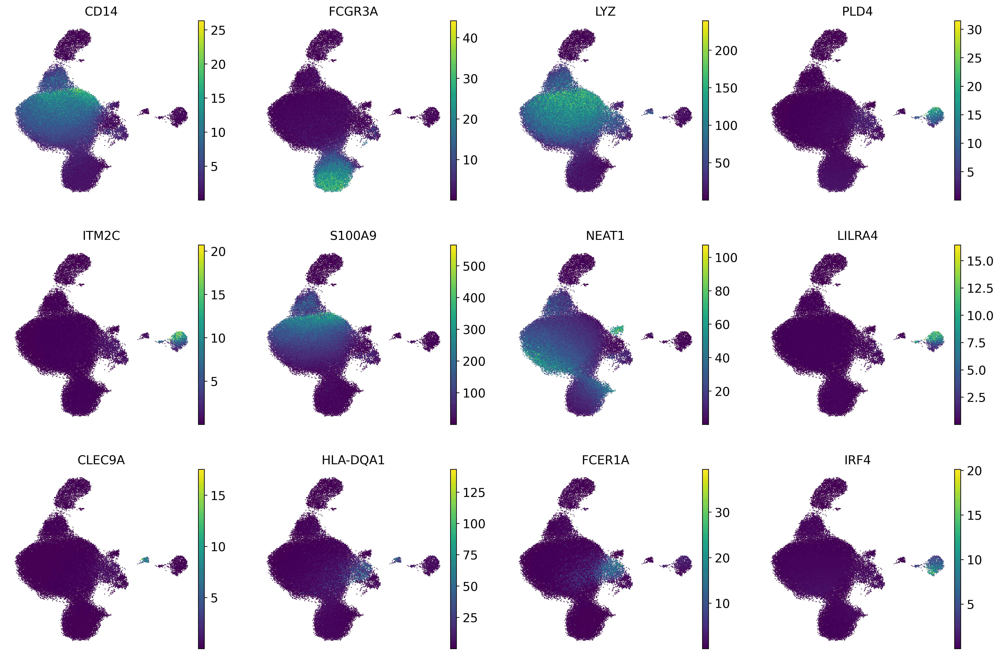

In [12]:
sc.set_figure_params(dpi=200)
sc.pl.umap(adata, color = ['CD14','FCGR3A','LYZ','PLD4','ITM2C','S100A9','NEAT1','LILRA4','CLEC9A','HLA-DQA1','FCER1A','IRF4'], size = 4, frameon = False, layer = 'scvi_normalized')

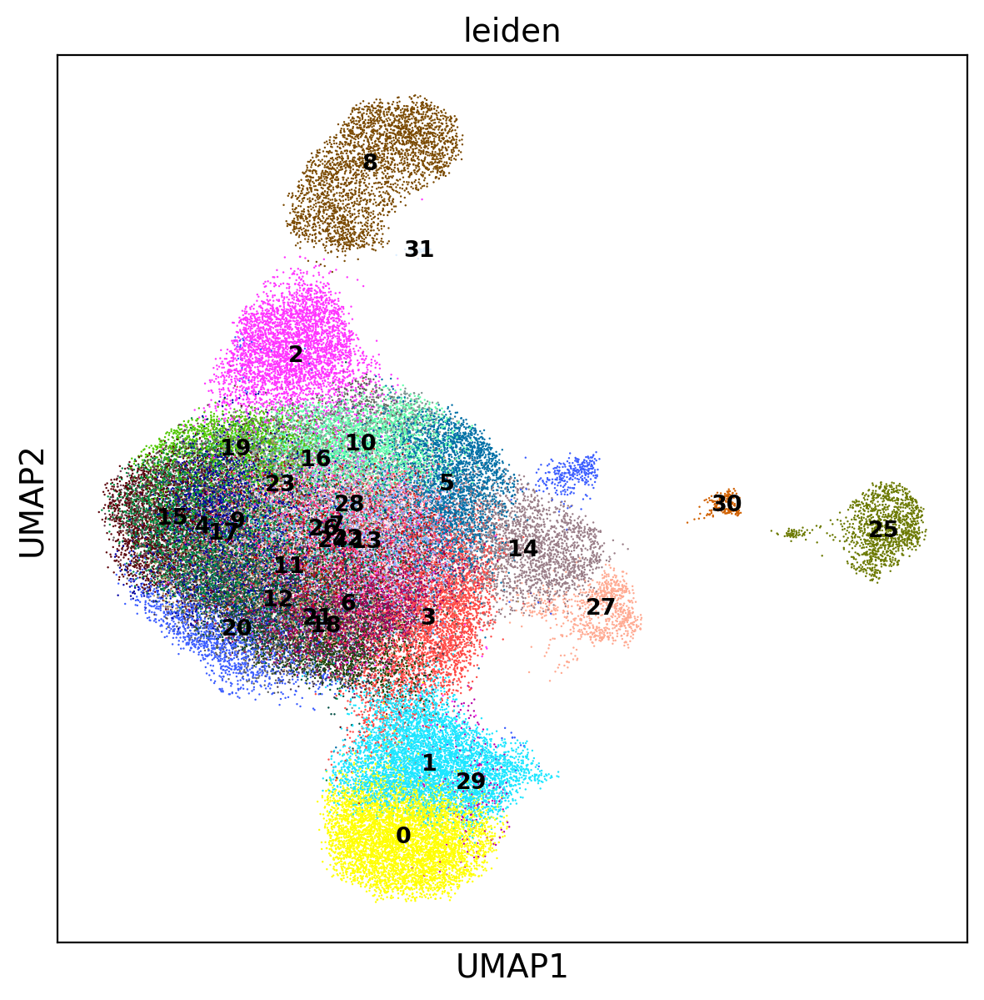

In [13]:
sc.set_figure_params(dpi=100)
plt.rcParams['figure.figsize'] = [7,7]
sc.pl.umap(adata, color = ['leiden'], legend_loc = 'on data', size = 3, layer = 'scvi_normalized', legend_fontsize = 'x-small')

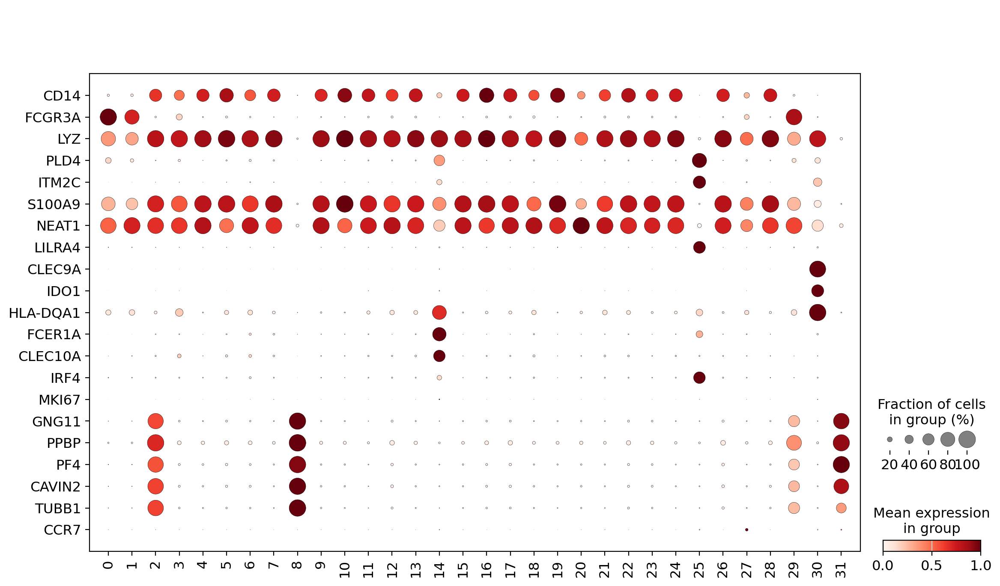

In [14]:
sc.set_figure_params(dpi=100)
sc.pl.dotplot(adata, ['CD14','FCGR3A','LYZ','PLD4','ITM2C','S100A9','NEAT1','LILRA4','CLEC9A','IDO1','HLA-DQA1','FCER1A','CLEC10A','IRF4','MKI67','GNG11','PPBP','PF4','CAVIN2','TUBB1','CCR7'], groupby = 'leiden', swap_axes = True,
              use_raw = True, standard_scale = 'var', dendrogram = False)

In [15]:
sc.tl.rank_genes_groups(adata, groupby='leiden', method='t-test')

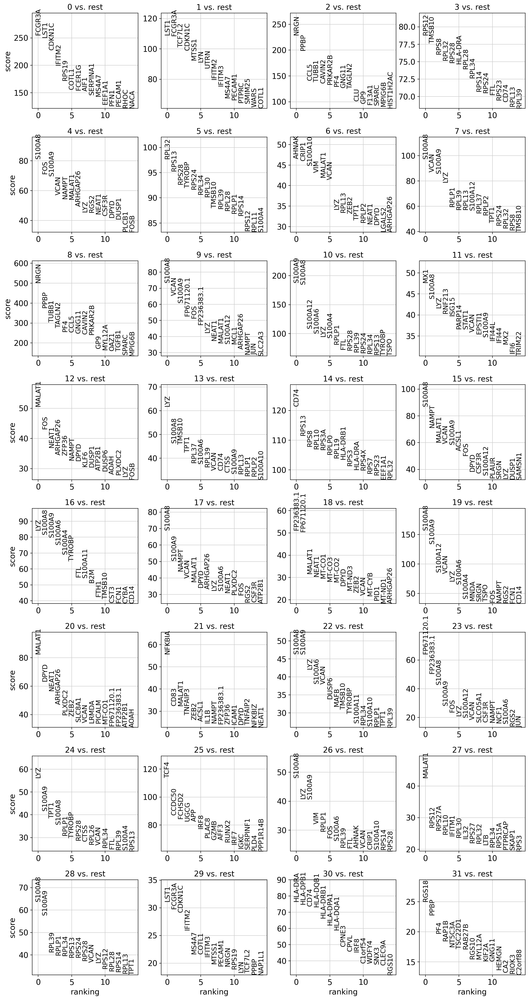

In [16]:
sc.pl.rank_genes_groups(adata, n_genes=15, sharey=False, fontsize = 12)

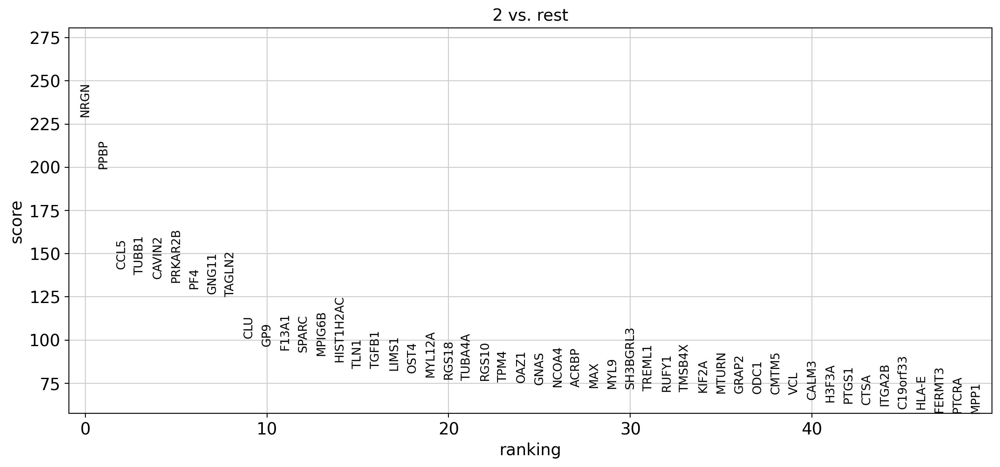

In [21]:
plt.rcParams['figure.figsize'] = [14, 6] # width, height
sc.pl.rank_genes_groups(adata, n_genes=50, groups=['2'], sharey=False, fontsize = 10)

In [20]:
#uclus = adata.obs['leiden'].values.unique()
#for i in range(0,len(uclus)):
#    print("'" + str(i) + "': '" + "',")

In [22]:
cell_type_dict = {
'0': 'nMo',
'1': 'nMo',
'2': 'MPA+sim',
'3': 'cMo',
'4': 'cMo',
'5': 'cMo',
'6': 'cMo',
'7': 'cMo',
'8': 'Platelet',
'9': 'cMo',
'10': 'cMo',
'11': 'cMo',
'12': 'cMo',
'13': 'cMo',
'14': 'cDC2',
'15': 'cMo',
'16': 'cMo',
'17': 'cMo',
'18': 'cMo',
'19': 'cMo',
'20': 'cMo',
'21': 'cMo',
'22': 'cMo',
'23': 'cMo',
'24': 'cMo',
'25': 'pDC',
'26': 'cMo',
'27': 'migratory myeloid',
'28': 'cMo',
'29': 'nMo+platelet',
'30': 'cDC1',
'31': 'Platelet'
}

In [23]:
adata.obs['cell_type'] = adata.obs['leiden'].map(cell_type_dict)

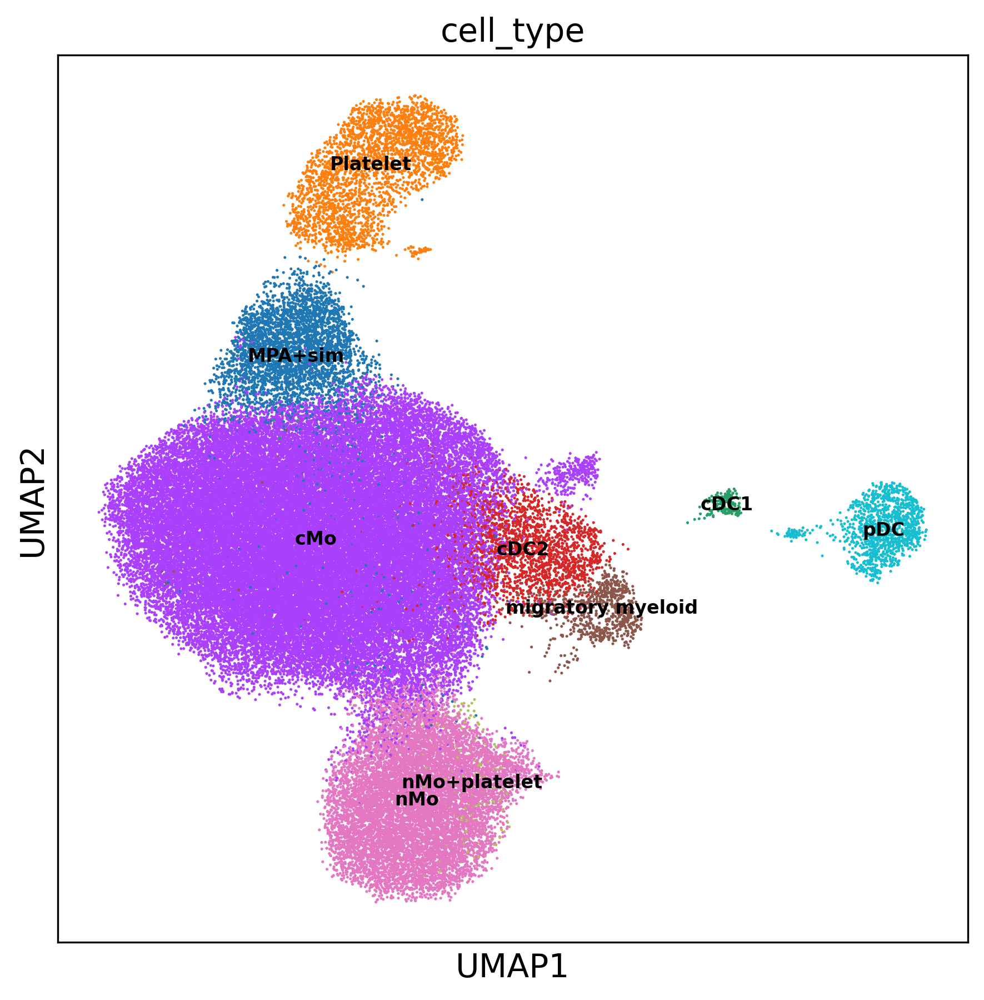

In [25]:
sc.set_figure_params(dpi=150)
plt.rcParams['figure.figsize'] = [7,7]
sc.pl.umap(adata, color = ['cell_type'], legend_loc = 'on data', size = 6, layer = 'scvi_normalized', legend_fontsize = '8')

In [26]:
adata.write_h5ad('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_myeloid_platelet_int_sim.h5ad')
#adata = sc.read_h5ad('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_myeloid_platelet_int_sim.h5ad')

In [27]:
adata_sim = adata[adata.obs['cell_type']=='MPA+sim']; adata_sim

View of AnnData object with n_obs × n_vars = 3966 × 20745
    obs: 'lane', 'souporcell_status', 'souporcell_assignment', 'study_id', 'barcode_2', 'map_sd', 'study_day', 'solo_prediction', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_MT', 'log1p_total_counts_MT', 'pct_counts_MT', 'n_genes', '_scvi_batch', '_scvi_labels', 'leiden', 'simulated', 'cell_type'
    var: 'n_cells', 'MT', 'highly_variable'
    uns: '_scvi_manager_uuid', '_scvi_uuid', 'log1p', 'neighbors', 'umap', 'leiden', 'lane_colors', 'study_id_colors', 'study_day_colors', 'simulated_colors', 'leiden_colors', 'rank_genes_groups', 'cell_type_colors'
    obsm: '_scvi_extra_categorical_covs', '_scvi_extra_continuous_covs', 'X_scVI', 'X_umap'
    layers: 'counts', 'scvi_normalized'
    obsp: 'distances', 'connectivities'

In [29]:
rna_counts = adata_sim.layers['counts'] # whole integer counts, no normalization
adata_obs = adata_sim.obs
adata_var = adata_sim.var

mmwrite('/media/MPEdge16/MM137/sc/py/py_out/pbmc/anndata_elements/adata_pbmc_counts_mpa_sim.mtx', rna_counts)
adata_obs.to_csv('/media/MPEdge16/MM137/sc/py/py_out/pbmc/anndata_elements/adata_pbmc_obs_mpa_sim.csv')
adata_var.to_csv('/media/MPEdge16/MM137/sc/py/py_out/pbmc/anndata_elements/adata_pbmc_var_mpa_sim.csv')